# Activations

Previously we used Keras to calculate the outputs of a convolutional neural network. As we saw, the VGG network is made up of several layers that separate the input pixels and the output classification results.

In this part, we'll do the same thing, but instead of doing it for the output layer, we're going to look at different layers in the network to see what the corresponding neurons are looking for.

We're going to build "activation maps". As our network is convolutional, we'll visualise them in a 2D grid.

# Preliminaries

Feel free to skip these; they're the same code as before.

In [409]:
import os
os.environ['KERAS_BACKEND'] = 'theano'


%matplotlib inline
from matplotlib import pyplot as plt
from __future__ import division, print_function

from keras.preprocessing.image import load_img, img_to_array
import numpy as np
from scipy.misc import imsave
from scipy.optimize import fmin_l_bfgs_b

In [410]:
from keras.applications import vgg16
from keras import backend as K
from keras.layers import Input

In [411]:
def preprocess_image(image_path):
    img = load_img(image_path, target_size=(224, 224))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg16.preprocess_input(img)
    return img

In [412]:
potato = preprocess_image("../images/potato.jpg")
hotdog = preprocess_image("../images/mystery.jpg")

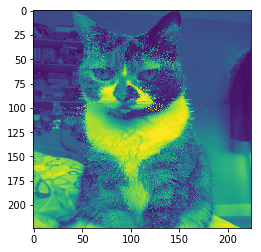

In [413]:
plt.imshow(potato[0,:,:,0])

# Reversing the VGG image processing

As we saw in the last part, our images are 224x224 pixels in 3 colour channels. To make training easier, the VGG creators pre-proces the image by mean-shifting each channel to 0. That means the average of each channel is 0 (by calculating the average colour of the original ImageNet training set). The below function reverses this operation by adding the averages back.

In [414]:
# util function to convert a tensor into a valid image
def deprocess_image(x):
    if K.image_dim_ordering() == 'th':
        x = x.reshape((3, 224, 224))
        x = x.transpose((1, 2, 0))
    else:
        x = x.reshape((224, 224, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

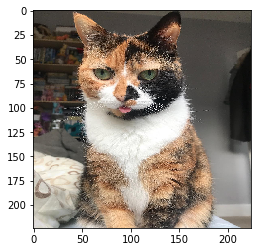

In [415]:
plt.imshow(deprocess_image(potato))

# Inspecting the model

In this example, we're going to add a new input layer to the model (we'll see why later).

In [416]:
dream = Input(batch_shape=(1,) + (224,224,3))

In [417]:
# build the VGG16 network with our placeholder
# the model will be loaded with pre-trained ImageNet weights
model = vgg16.VGG16(input_tensor=dream,
                    weights='imagenet', include_top=True)

In [418]:
# get the symbolic outputs of each "key" layer (we gave them unique names).
layer_dict = dict([(layer.name, layer) for layer in model.layers])

In [419]:
model.layers

In [420]:
layer_dict

{'block1_conv1': <keras.layers.convolutional.Conv2D at 0x1198c2860>,
 'block1_conv2': <keras.layers.convolutional.Conv2D at 0x121010e10>,
 'block1_pool': <keras.layers.pooling.MaxPooling2D at 0x1218d9470>,
 'block2_conv1': <keras.layers.convolutional.Conv2D at 0x11f2af080>,
 'block2_conv2': <keras.layers.convolutional.Conv2D at 0x11f86acf8>,
 'block2_pool': <keras.layers.pooling.MaxPooling2D at 0x1170d5cf8>,
 'block3_conv1': <keras.layers.convolutional.Conv2D at 0x11fe99a90>,
 'block3_conv2': <keras.layers.convolutional.Conv2D at 0x1146447f0>,
 'block3_conv3': <keras.layers.convolutional.Conv2D at 0x11b3b5f98>,
 'block3_pool': <keras.layers.pooling.MaxPooling2D at 0x11cadcf98>,
 'block4_conv1': <keras.layers.convolutional.Conv2D at 0x119de6048>,
 'block4_conv2': <keras.layers.convolutional.Conv2D at 0x11a973ba8>,
 'block4_conv3': <keras.layers.convolutional.Conv2D at 0x115afc128>,
 'block4_pool': <keras.layers.pooling.MaxPooling2D at 0x11ef1d390>,
 'block5_conv1': <keras.layers.convolu

In [421]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_17 (InputLayer)        (1, 224, 224, 3)          0         
_________________________________________________________________
block1_conv1 (Conv2D)        (1, 224, 224, 64)         1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (1, 224, 224, 64)         36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (1, 112, 112, 64)         0         
_________________________________________________________________
block2_conv1 (Conv2D)        (1, 112, 112, 128)        73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (1, 112, 112, 128)        147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (1, 56, 56, 128)          0         
__________

# Pulling out activations

What we're going to do is show the activation map for each layer. We do this by showing an image to the network, then recording the outputs of each filter.

There are a couple of important things to remember: VGGnet's layers are (mostly) convolutional, so there's a small number of neurons. Each layer has more than one set of neurons associated with it. The dimensions of each layer correspond to the *output* size (X,Y) and the number of filters. So, the layer block5_conv1 produces 512 14x14 pixel images.

The following two functions first record the output values at the layer when given the `potato.jpg` image we've been working with. The `visualise_layer` function plots each of the filtered convolved images in turn.

In [422]:
def get_activations(layername):
    activations = K.function([model.layers[0].input],[layer_dict[layername].output])
    x = preprocess_image("../images/potato.jpg")
    layer_output = activations([x])[0]
    return layer_output[0]

In [423]:
def visualise_layer(layername):
    layer = get_activations(layername)
    f = plt.figure(figsize=(32,256))

    f.subplots_adjust(hspace=0.4, wspace=0.2)

    count = layer.shape[2]
    cols = 3
    for x in range(count):
        #plt.subplot(1+round(count/cols),cols,x+1)
        ax = f.add_subplot(1+round(count/cols),cols,x+1)
        ax.imshow(layer[:,:,x],aspect=1)

# The first convolution

First, let's visualise the output of the first layer. This layer is a suite of 64 filters, each convolving 3x3 blocks of pixels. Visualising the layers show how the convolution can be used to detect edges in the images. At this stage, the features the filters are most "interested" in are small regions (because that's all the convolution operators can see).

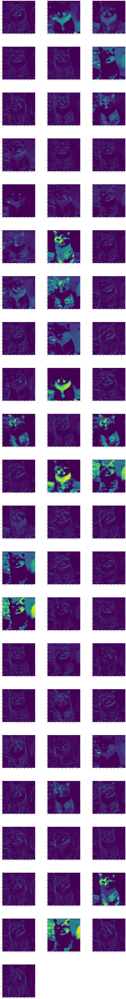

In [424]:
visualise_layer('block1_conv1')


# Conv2

The second layer uses another 64 filters, but this time, each 3x3 convolution block sees 9 pixels with 64 channels - each output of each filter in the previous block.

This allows the network to start mixing low-level filters to produce higher order features.

Note that when the network is trained, each weight is updated, so there's synergy between the weights in the earlier blocks and the weights in the later blocks.

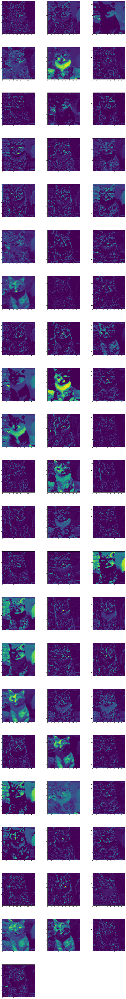

In [425]:
visualise_layer('block1_conv2')

# Pooling

The next layer in the network downsamples the image using max-pooling. For each block of pixels, one pixel value is chosen using the maximum value. The plots below look similar to the ones above, but the resolution is halved.

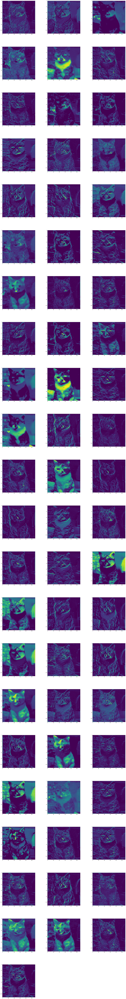

In [426]:
visualise_layer('block1_pool')

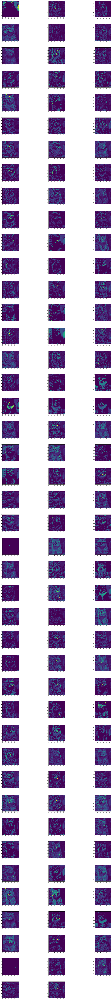

In [427]:
visualise_layer('block2_conv1')

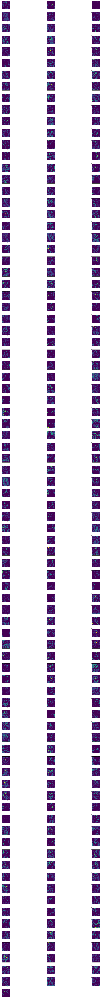

In [428]:
visualise_layer('block3_conv1')

# Deeper filters

As we go further down the network, the size of the output decreases, but so does the number of filters. As the image has been downsampled, there's less connection with the original image. Hotspots in these activation maps correspond to larger shapes that are useful for general image recognition (there should be at least one that identifies round objects like eyes, for example).

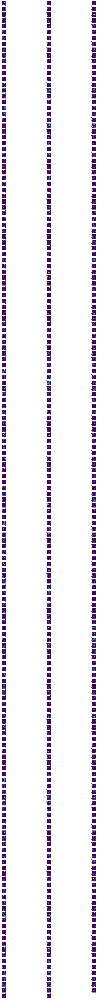

In [429]:
visualise_layer('block4_conv1')

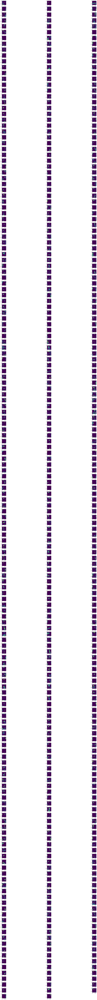

In [430]:
visualise_layer('block5_conv1')

# Deep Dream: Optimising Images

Ordinarily when training networks we'd optimise the weights in the network. We don't have to do that. We can instead represent the input image as $224 * 224 * 3$ variables. We can use the same machinery to find more optimal weights for an arbitrary function we can choose.

[Deep Dream](https://en.wikipedia.org/wiki/DeepDream) works by tweaking the input image, recording activations from specific layers, and calculating the difference between the activations and a "desired" value. In this case, we'll run the network on one image, record the activations, and then try to find an image that increases the activations in each layer.

This produces weird images, depending on the layers picked and the weights applied to them.

For this exercise, first, follow each chunk and evaluate it in place. Then when you get to the end, come back to this point and start experimenting.


This part of the exercise is shamelessly butchered from Daniel Varga's [Deep Dream Keras implementation](https://github.com/danielvarga/keras-deep-dream/blob/master/deep_dream.py).

In [471]:
interested_layers = ['block5_conv1',
                     'block5_conv2',
                     'block5_conv3',
                     #'block5_conv3',
                     #'block3_conv1',
                     #'block4_conv1',
                     'block4_conv2',
                     'block4_conv3',
                     'block3_conv2',
                     'block3_conv1',
                     'block2_conv2',
                     # 'block1_conv1'
                    ]
layers = {l:get_activations(l) for l in interested_layers}

We describe the optimisation problem with a loss function, which we want to minimise. First, we take the difference between the outputs of the layer when we showed it the original image, and the layer when the network sees the current image. We want to reduce the average difference in this case.

In [472]:
loss = K.variable(0.)
for layer in layers.keys():
    print(layer)
    x = layer_dict[layer].output
    activation = layers[layer]
    print(activation.shape)
    print(layer_dict[layer].output_shape)
    loss -= 0.006* K.mean(K.square(x[0,:,:,:] - activation))
    # Use this if you want to try using the output layer instead of an intermediate layer
    #loss -= 0.006* K.mean(K.square(x[0,:] - activation))

block5_conv1
(14, 14, 512)
(1, 14, 14, 512)
block5_conv2
(14, 14, 512)
(1, 14, 14, 512)
block5_conv3
(14, 14, 512)
(1, 14, 14, 512)
block4_conv2
(28, 28, 512)
(1, 28, 28, 512)
block4_conv3
(28, 28, 512)
(1, 28, 28, 512)
block3_conv2
(56, 56, 256)
(1, 56, 56, 256)
block3_conv1
(56, 56, 256)
(1, 56, 56, 256)
block2_conv2
(112, 112, 128)
(1, 112, 112, 128)


We could stop here and try to optimise the image, but it leaves the optimiser free to change adjacent pixels drastically. We can define a notion of "continuity" by subtracting the image from versions of itself offset horizontally and vertically. We want to make adjacent pixels similar by reducing this difference.

In [473]:
def continuity_loss(x):
    img_width = 224
    img_height = 224
    assert K.ndim(x) == 4
    if K.image_dim_ordering() == 'th':
        a = K.square(x[:, :, :img_width - 1, :img_height - 1] -
                     x[:, :, 1:, :img_height - 1])
        b = K.square(x[:, :, :img_width - 1, :img_height - 1] -
                     x[:, :, :img_width - 1, 1:])
    else:
        a = K.square(x[:, :img_width - 1, :img_height-1, :] -
                     x[:, 1:, :img_height - 1, :])
        b = K.square(x[:, :img_width - 1, :img_height-1, :] -
                     x[:, :img_width - 1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))

In [474]:
loss += 0.5 * continuity_loss(dream) / (224 * 224)

The optimiser may also try to make the entire image white, so we can constrain it further by penalising overly bright images.

In [475]:
loss += 0.4 * K.sum(K.square(dream)) / (224 * 224)

When we optimise the image we need the loss function and we also need to differentiate the loss function with respect to each variable (in our case each pixel is 3 variables).

This will return a vector with the loss function followed by the gradient for each pixel. Keras handles computation symbolically (this allows it to calculate gradients for us).

In [476]:
grads = K.gradients(loss, dream)
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

outputs = [loss]
outputs.append(grads)

f_outputs = K.function([dream], outputs)

Given our symbolic function `f_outputs`, if we provide it an input of pixel values we need a way to evaluate it. We do that by invoking it. When we do that, we get the vector described earlier: the loss value and the gradients.

In [477]:
def eval_loss_and_grads(x):
    x = x.reshape((1,) + (224,224,3))
    outs = f_outputs([x])
    loss_value = outs[0]
    if len(outs[1:]) == 1:
        grad_values = outs[1].flatten().astype('float64')
    else:
        grad_values = np.array(outs[1:]).flatten().astype('float64')
    return loss_value, grad_values

In [478]:
# this Evaluator class makes it possible
# to compute loss and gradients in one pass
# while retrieving them via two separate functions,
# "loss" and "grads". This is done because scipy.optimize
# requires separate functions for loss and gradients,
# but computing them separately would be inefficient.
class Evaluator(object):
    def __init__(self):
        self.loss_value = None
        self.grad_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

evaluator = Evaluator()

Now we have defined the loss function, computed the gradient, and have our inputs. What's left is to use the optimiser to find a new image. We do this iteratively.

At each iteration we seed the image with some noise. This should cause some of the activations to light up in some areas, guiding the optimiser to amplify the features to further increase the activations.

Start of iteration 0
Current loss value: 9840.74092696668


/Users/mat/Documents/Keras/lib/python3.6/site-packages/ipykernel_launcher.py:23: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


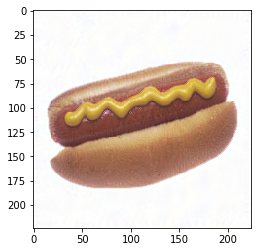

Image saved as dream_image_at_iteration_0.png
Iteration 0 completed
Start of iteration 1
Current loss value: 7651.544444161564


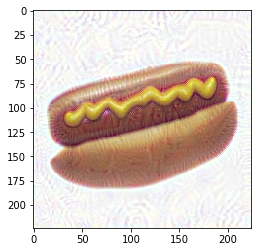

Image saved as dream_image_at_iteration_1.png
Iteration 1 completed
Start of iteration 2
Current loss value: 5390.0141531905665


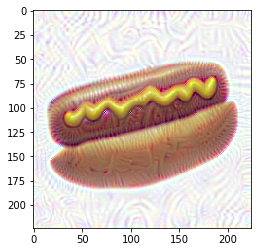

Image saved as dream_image_at_iteration_2.png
Iteration 2 completed
Start of iteration 3
Current loss value: 2909.8303503124243


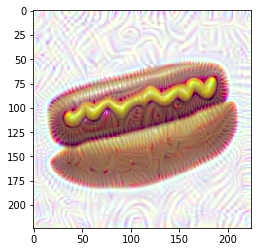

Image saved as dream_image_at_iteration_3.png
Iteration 3 completed
Start of iteration 4
Current loss value: -93.90649609967113


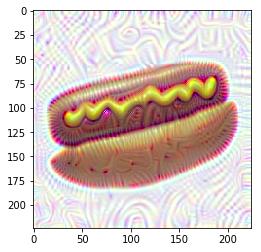

Image saved as dream_image_at_iteration_4.png
Iteration 4 completed
Start of iteration 5
Current loss value: -3868.6680248650355


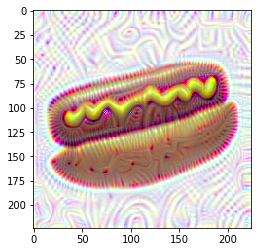

Image saved as dream_image_at_iteration_5.png
Iteration 5 completed
Start of iteration 6
Current loss value: -8317.242067552192


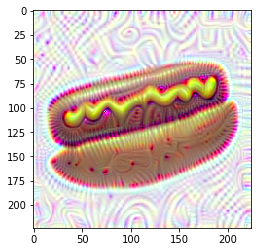

Image saved as dream_image_at_iteration_6.png
Iteration 6 completed
Start of iteration 7
Current loss value: -13100.096142927225


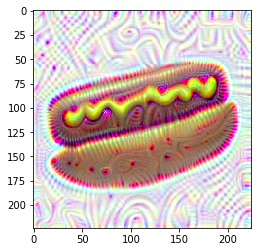

Image saved as dream_image_at_iteration_7.png
Iteration 7 completed
Start of iteration 8
Current loss value: -25588.77539736907


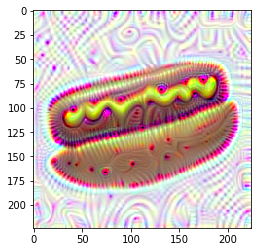

Image saved as dream_image_at_iteration_8.png
Iteration 8 completed
Start of iteration 9
Current loss value: -37782.88519306823


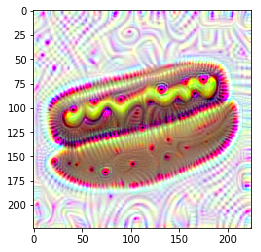

Image saved as dream_image_at_iteration_9.png
Iteration 9 completed


In [479]:
# run scipy-based optimization (L-BFGS) over the pixels of the generated image
# so as to minimize the loss
x = preprocess_image("../images/mystery.jpg")
result_prefix="dream_image"
for i in range(10):
    print('Start of iteration', i)


    # add a random jitter to the initial image. This will be reverted at decoding time
    random_jitter = 0.01 * (np.random.random((224,224,3)) - 0.5)
    #random_jitter = 0.4 * (np.random.random((224,224,3)) - 0.5)
    x += random_jitter

    # run L-BFGS for 7 steps
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=7)
    print('Current loss value:', min_val)
    # decode the dream and save it
    x = x.reshape((224,224,3))
    x -= random_jitter
    img = deprocess_image(np.copy(x))
    fname = result_prefix + '_at_iteration_%d.png' % i
    imsave(fname, img)
    plt.imshow(img)
    plt.show()
    print('Image saved as', fname)
    print('Iteration %d completed' % i)

In [480]:
from keras.applications.vgg16 import decode_predictions

In [481]:
vggmodel = vgg16.VGG16(weights='imagenet', include_top=True)

In [482]:
img = preprocess_image("../images/mystery.jpg")

In [483]:
predictions = vggmodel.predict(img)
decode_predictions(predictions)

[[('n07697537', 'hotdog', 0.9998751),
  ('n07697313', 'cheeseburger', 4.4649973e-05),
  ('n07684084', 'French_loaf', 2.871024e-05),
  ('n07695742', 'pretzel', 1.5518677e-05),
  ('n02776631', 'bakery', 1.0181494e-05)]]

After generating the images, we can see what the original network classifies the outputs as as we modify it. As the image gets more distorted, we can see how the confidence in the hotdog-ness of the image falls away. Eventually the image stops looking like a hotdog entirely and more like a pencil box to the network.

This highlights how adversarial examples work in principle; by adding the right shaped noise to the image, we end up with something that still looks like a hotdog to a human, but to the network it looks like a pencil box.

In [484]:
for iteration in range(10):
    print('iteration {} predictions'.format(iteration))
    print(decode_predictions(vggmodel.predict(preprocess_image("dream_image_at_iteration_{}.png".format(iteration))))[0][0:1])

iteration 0 predictions
[('n07697537', 'hotdog', 0.9997346)]
iteration 1 predictions
[('n07697537', 'hotdog', 0.986943)]
iteration 2 predictions
[('n07697537', 'hotdog', 0.7596492)]
iteration 3 predictions
[('n07697537', 'hotdog', 0.3194268)]
iteration 4 predictions
[('n03938244', 'pillow', 0.30511945)]
iteration 5 predictions
[('n03938244', 'pillow', 0.3094287)]
iteration 6 predictions
[('n03908618', 'pencil_box', 0.34410256)]
iteration 7 predictions
[('n03908618', 'pencil_box', 0.67575955)]
iteration 8 predictions
[('n03908618', 'pencil_box', 0.75144583)]
iteration 9 predictions
[('n03908618', 'pencil_box', 0.87395656)]


In [485]:
from keras.preprocessing.image import load_img, img_to_array

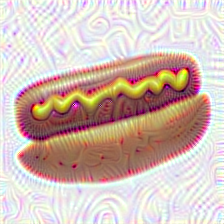

In [486]:
load_img("dream_image_at_iteration_4.png")

# Things to try

There are a lot of free parameters to experiment with. Head back up to the notebook at the start of the deep dream section and start experimenting to see what type of images result.

* Change the layers used to calculate the loss function
* Change the weights on the layer loss
* Change the weight on the continuity loss
* Change the weight on the sum squared loss
* Change the noise
* Change the input image
* Change the image used for the activations
* Use the output layer instead of the intermediate layers (you'll need to tweak some of the other weights to get this to work)